In [1]:
%load_ext autoreload
%autoreload 2


import scanpy as sc
import seaborn as sns
import pandas as pd
from scipy.stats import median_abs_deviation
from sklearn.mixture import GaussianMixture
import numpy as np
import matplotlib.pyplot as plt
import scrublet as scr
from tqdm.notebook import tqdm
from diptest import diptest
from scipy.sparse import csr_matrix
import anndata as ad
import math


from utils import preprocessing

# Hyperparamyters
LIBRARY = "H3"


# Goals

- QC metrics
- Plot cell type annotaions

# Load Adata

In [ ]:
ADATA_PATH = f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/labelled_adata.h5ad'
adata = sc.read_h5ad(ADATA_PATH)

print(adata)

# Calculate QC Metrics

In [ ]:
# Calculate qc
adata.var["mt"] = adata.var.gene_symbol.str.startswith("MT-") # mitochondrial genes, ATTNETION: the names are in "gene_symbol"
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], inplace=True)

In [ ]:
preprocessing.plot_qc_metrics(adata)

# Minimal Filter cells & genes

In [ ]:
print(f"Starting: {adata.n_obs:,} cells\n")

# Calculate all filters (keep = pass filter)
filters = { # lists of boolen (True == to keep)
    
    'min_UMI': adata.obs["total_counts"] >= 500,
    'min_genes': adata.obs["n_genes_by_counts"] >= 200,
    'mt_threshold': adata.obs["pct_counts_mt"] <= 8,
    'is_cell_dropsift': adata.obs["is_cell"] == True,
    'percent_intronic_threshold': adata.obs["pct_intronic"] >= 0.25,
    'mapmycells_probs_class': (adata.obs['Class_bootstrapping_probability'] >= 0.5), # & (adata.obs['Class_correlation_coefficient'] >= 0.5),
    #'spatial_present': ~adata.obs.has_spatial,
}

# Print individual filter stats
n_start = len(adata)
for name, filt in filters.items():
    removed = (~filt).sum()
    print(f"{name:30s}: {removed:6,} removed ({100*removed/len(adata):5.1f}%)")

# Replace adata
cells_to_keep = pd.DataFrame(filters).all(axis=1)  # AND
adata = adata[cells_to_keep].copy()

print(f"Final: {adata.n_obs:,} / {n_start:,} cells retained ({100*adata.n_obs/n_start:.1f}%)")

In [ ]:
# Filter genes
print(f"   Genes before filtering: {adata.n_vars}")
sc.pp.filter_genes(adata, min_cells=3)
print(f"   Genes after filtering: {adata.n_vars}")

In [ ]:
preprocessing.plot_qc_metrics(adata)

# Processing Pipeline

In [ ]:
preprocessing.preprocess(adata, n_pcs_elbow=30, n_hvg=3000)

In [ ]:
# Plor ledein clistering

fig, axes = plt.subplots(4, 2, figsize=(10, 15))

adata_spatial = ad.AnnData(X=csr_matrix(adata.X.shape),obs=adata.obs.copy(),var=adata.var.copy(),uns=adata.uns.copy(),obsm=adata.obsm.copy())
adata_spatial = adata_spatial[adata_spatial.obs.has_spatial]

for i, res in enumerate(["leiden_1", "leiden_2", "leiden_3", "leiden_4"]):
    sc.pl.embedding(adata_spatial, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_loc="on data")

plt.tight_layout()
plt.show()

# Investigate PCs

In [ ]:
preprocessing.show_top_pc_genes(adata, n_pcs=3, top_n=10)

**PC1: Oligodendrocytes ↔ Neurons**

Positive (Neuronal):
  CELF2, ARHGAP26, KCNMA1, SLC8A1, NEBL
  → Neuronal genes (ion channels, synaptic)

Negative (Oligodendrocyte):
  PLP1 (-0.058) ← MAJOR myelin gene!
  APOD, LAMA2
  → Oligodendrocyte/myelin genes

**PC2: Astrocytes vs Oligodendrocytes**

Positive (Astrocytes):
AQP4, SLC1A2, ATP1A2, ETNPPL = Classic astrocyte markers

Negative (Oligodendrocytes):
MBP, MOG, MOBP, PLP1, TF = Myelin genes (oligodendrocytes)

**PC3: Microglia vs Astrocytes**

Positive (Microglia/Immune):
CD74, PTPRC (CD45), CSF1R, INPP5D = Microglia/immune cell markers

Negative (Astrocytes):
Same astrocyte genes from PC2
  → Canonical astrocyte markers

# Save Minimal filtered Adata

In [ ]:
adata.write(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/minimal_filtered_adata.h5ad')
del(adata)

In [2]:
adata = sc.read_h5ad(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/minimal_filtered_adata.h5ad')

In [ ]:
# Plot map my cell cell types
fig, axes = plt.subplots(2, 2, figsize=(15, 15))

adata_spatial = ad.AnnData(X=csr_matrix(adata.X.shape),obs=adata.obs.copy(),var=adata.var.copy(),uns=adata.uns.copy(),obsm=adata.obsm.copy())
adata_spatial = adata_spatial[adata_spatial.obs.has_spatial]

for i, res in enumerate(["Subclass_name"]):
    sc.pl.embedding(adata_spatial, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_fontsize=6, legend_loc="on data")

plt.tight_layout()
plt.show()


# QC metrics on umap

In [ ]:
fig, axes = plt.subplots(5, 2, figsize=(10, 15))

adata_spatial = ad.AnnData(X=csr_matrix(adata.X.shape),obs=adata.obs.copy(),var=adata.var.copy(),uns=adata.uns.copy(),obsm=adata.obsm.copy())
adata_spatial = adata_spatial[adata_spatial.obs.has_spatial]

for i, res in enumerate(["log1p_total_counts", "log1p_n_genes_by_counts", "pct_intronic", "pct_counts_mt", "Class_bootstrapping_probability"]):
    sc.pl.embedding(adata_spatial, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_loc=None)

plt.tight_layout()
plt.show()

# Cell type markers

In [3]:
markers = {
    # Non-neuronal cells
    'Astrocyte': ['GFAP', 'AQP4', 'GINS3'],
    
    'Ependymal': ['ZBBX'],
    
    'Endothelial': ['DCN', 'FLT1'],
    
    'Lymphocyte': ['SKAP1', 'THEMIS'],
    
    'Microglia': ['CX3CR1', 'P2RY12', 'C1QA', 'C1QB', 'C1QC'],
    
    'Macrophage': ['CD163', 'CD200R1'],
    
    'Oligodendrocyte': ['TF', 'PLP1', 'MOBP', 'TMEM144'], #['MOBP', 'TF', 'PLP1'],#'SHROOM4', 'TF'], MBP
    
    'OPC': ['VCAN', 'PDGFRA'],
    
    # Neurons - using ONLY subtype-specific markers (no RBFOX3/SYT1 overlap)
    'Neuron_inhibitory': ['GAD1', 'GAD2', 'SLC32A1'],
    
    'Neuron_excitatory': ['SLC17A6', 'SLC17A7', 'SLC17A8'],
    
    'Neuron_dopaminergic': ['SLC6A3', 'TH'],
    
    'Neuron_cholinergic': ['CHAT'],
    
    'Neuron_serotonergic': ['SLC6A4'],
}

mapping_genes_name_dict = adata.var[["gene_symbol"]].to_dict()["gene_symbol"].copy()
symbol_to_varid = {v.upper(): k for k, v in mapping_genes_name_dict.items() if isinstance(v, str)}
translated_markers = {
    celltype: [symbol_to_varid.get(gene.upper(), None) for gene in genes]
    for celltype, genes in markers.items()
}

display(translated_markers)


{'Astrocyte': ['ENSG00000131095', 'ENSG00000171885', 'ENSG00000181938'],
 'Ependymal': ['ENSG00000169064'],
 'Endothelial': ['ENSG00000011465', 'ENSG00000102755'],
 'Lymphocyte': ['ENSG00000141293', 'ENSG00000172673'],
 'Microglia': ['ENSG00000168329',
  'ENSG00000169313',
  'ENSG00000173372',
  'ENSG00000173369',
  'ENSG00000159189'],
 'Macrophage': ['ENSG00000177575', 'ENSG00000163606'],
 'Oligodendrocyte': ['ENSG00000091513',
  'ENSG00000123560',
  'ENSG00000168314',
  'ENSG00000164124'],
 'OPC': ['ENSG00000038427', 'ENSG00000134853'],
 'Neuron_inhibitory': ['ENSG00000128683',
  'ENSG00000136750',
  'ENSG00000101438'],
 'Neuron_excitatory': ['ENSG00000091664',
  'ENSG00000104888',
  'ENSG00000179520'],
 'Neuron_dopaminergic': ['ENSG00000142319', 'ENSG00000180176'],
 'Neuron_cholinergic': ['ENSG00000070748'],
 'Neuron_serotonergic': ['ENSG00000108576']}

## Plot single markers expression

In [ ]:
gene_to_plot = set()
for key, item in markers.items():
    gene_to_plot.update(set(item))
    
sc.pl.umap(adata, color=gene_to_plot, cmap='viridis', ncols=4, gene_symbols="gene_symbol")#, vmin=-1, vmax=1)


## Plot Module score markers

  0%|          | 0/13 [00:00<?, ?it/s]

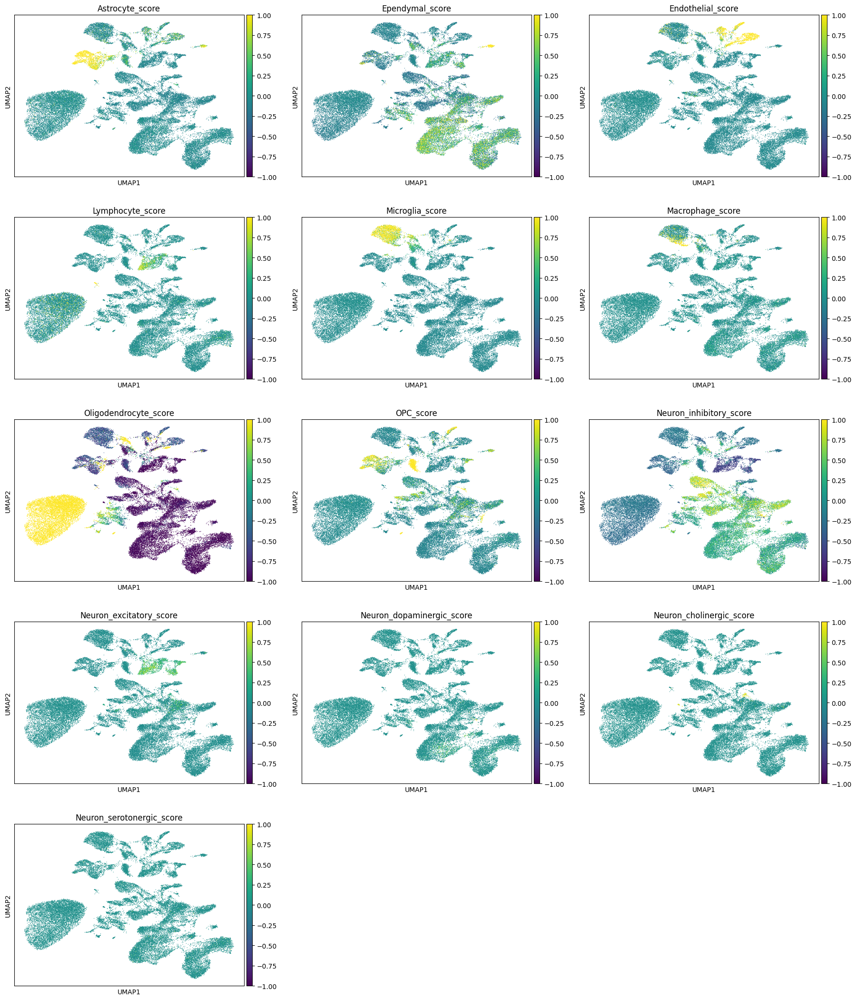

In [4]:
for cell_type, genes in tqdm(translated_markers.items()):
    # Only use genes that exist in your data
    #genes_available = [g for g in genes if g in adata.var.gene_symbol.to_list()]
    
    if len(genes) > 0:
        #print(f"  {cell_type}: {len(genes)} markers")
        sc.tl.score_genes(adata, genes, score_name=f'{cell_type}_score', use_raw=False, layer="log1p_norm") # normalised scores (not scaled)
    else:
        print(f"  ⚠ {cell_type}: No markers found!")

# plot umaps
score_cols = [f'{ct}_score' for ct in markers.keys() if f'{ct}_score' in adata.obs]
sc.pl.umap(adata, color=score_cols, cmap='viridis', ncols=3, vmin=-1, vmax=1)

## Plot Oligos Markers

In [ ]:
# Check if they're differentiating OPCs (real) or doublets (artifact)
#(Oligo + OPC)
# REAL BIOLOGY (good) ✓
# OPC differentiating into Oligodendrocyte
# → Transition state, should KEEP!
#  BCAS1 expression (differentiation marker) --> BCAS1 high → Real differentiating cells → KEEP ✓
sc.pl.umap(adata, color=['Subclass_name', 
                         'VCAN', # OPC
                         'BCAS1',  # differentiationg
                         'TF', 'PLP1', 'MOBP', 'TMEM144', # Mature Oligo
                         'SHROOM4', 'MBP', 'ST18'
                         ], gene_symbols="gene_symbol", ncols=3, legend_loc="on data")

## Plot Neun Markers

In [ ]:
sc.pl.umap(adata, color=['Subclass_name', 
                         'RBFOX3', 
                         ], gene_symbols="gene_symbol", ncols=3, legend_loc="on data")

# Remove Doublets clusters

excluding cell clusters that co-express marker genes of distinct cell types (not UMI based approach).

Problem: Homotypic doublets (formed by transcriptionally similar cells) cannot be detected this way

Check if the doublet cluster is positioned between its "parent" clusters in UMAP space


## Putative doublets by mix cell types

In [71]:
cluster_level_for_mix = "leiden_5"
cell_type_annotation_for_mix = "Subclass_name"

# Calcualte high res clusters
sc.tl.leiden(adata, resolution=10.0, key_added="leiden_5", flavor="igraph", n_iterations=2)

<Axes: title={'center': 'leiden_5'}, xlabel='UMAP1', ylabel='UMAP2'>

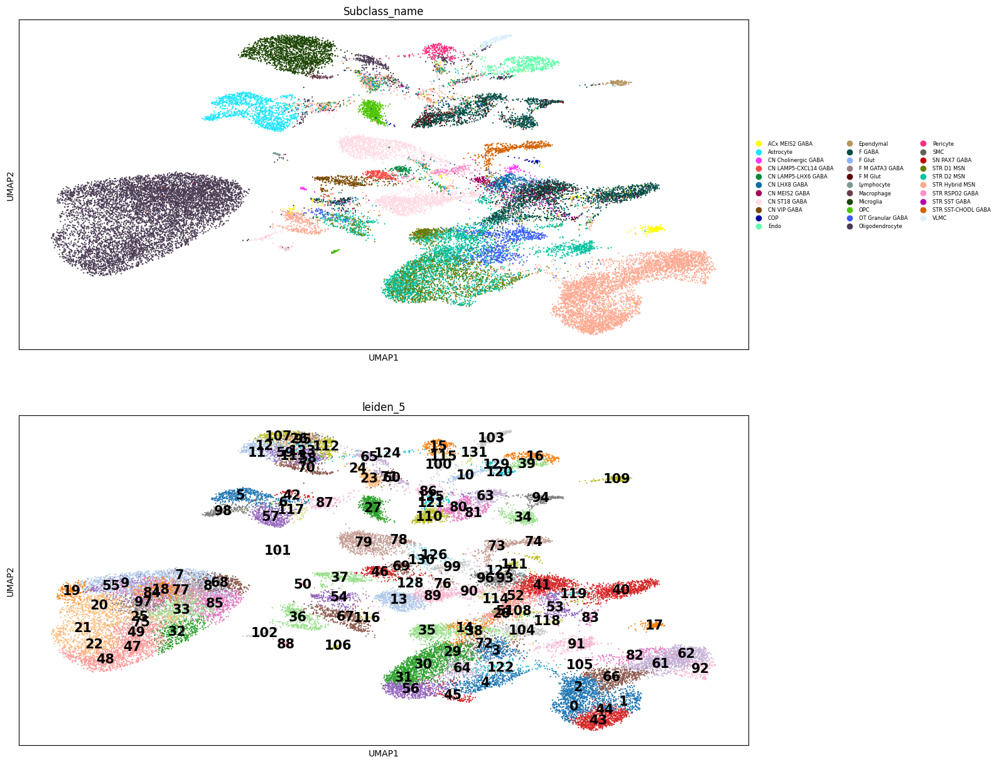

In [72]:
fig, axes = plt.subplots(2, 1, figsize=(15, 15))
sc.pl.umap(adata, color="Subclass_name", ax=axes[0], show=False, legend_fontsize=6, size=10)# legend_loc="lower center")

num_clusters = adata.obs[cluster_level_for_mix].nunique()
cmap = plt.get_cmap("tab20")  # or "turbo", "nipy_spectral", "gist_rainbow"
palette = [cmap(i / num_clusters) for i in range(num_clusters)]
sc.pl.umap(adata, color=cluster_level_for_mix, ax=axes[1], show=False, legend_fontsize=15, size=10, legend_loc="on data", palette=palette)

Proposed mixed clusters (high entropy): ['60', '10', '100', '54', '87', '52', '83']


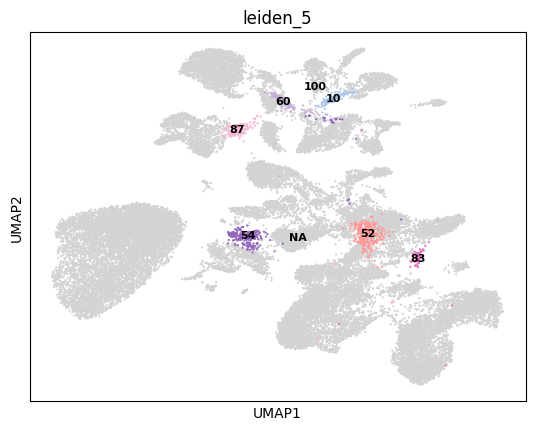

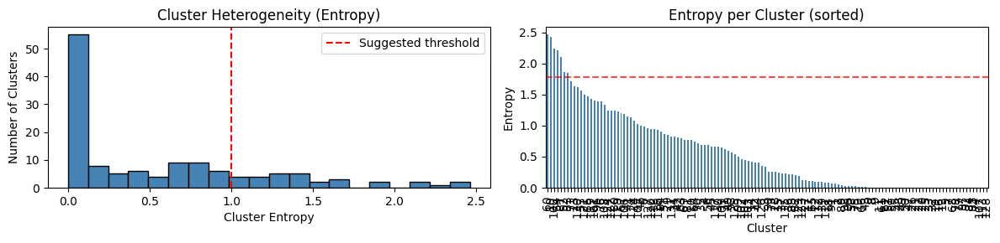

In [75]:
# Get composition (proportions per cluster)
cluster_composition = pd.crosstab(
    adata.obs[cluster_level_for_mix], 
    adata.obs[cell_type_annotation_for_mix],
    normalize='index'
)

# Calculate entropy per cluster
from scipy.stats import entropy
cluster_entropy = cluster_composition.apply(lambda row: entropy(row.values), axis=1)

# Propose high ebtrupy clusters
thr = cluster_entropy.quantile(0.95)
high_entropy_clusters = cluster_entropy[cluster_entropy > thr].sort_values(ascending=False).index.to_list()
print("Proposed mixed clusters (high entropy):", high_entropy_clusters )
sc.pl.umap(adata, color="leiden_5", show=False, legend_fontsize=8, size=10, legend_loc="on data", palette=palette, groups=high_entropy_clusters)

# Plot distruvtion
fig, axes = plt.subplots(1, 2, figsize=(12, 3))
# Entropy histogram
axes[0].hist(cluster_entropy, bins=20, edgecolor='black', color='steelblue')
axes[0].axvline(1.0, color='red', linestyle='--', label='Suggested threshold')
axes[0].set_xlabel('Cluster Entropy')
axes[0].set_ylabel('Number of Clusters')
axes[0].set_title('Cluster Heterogeneity (Entropy)')
axes[0].legend()
# Bar plot of entropy per cluster
cluster_entropy.sort_values(ascending=False).plot(kind='bar', ax=axes[1], color='steelblue')
axes[1].axhline(thr, color='red', linestyle='--', alpha=0.7)
axes[1].set_xlabel('Cluster')
axes[1].set_ylabel('Entropy')
axes[1].set_title('Entropy per Cluster (sorted)')
axes[1].tick_params(axis='x', rotation=90)
plt.tight_layout()
plt.show()



Doublets distribution:
is_mixed_cluster_doublet
False    34615
True       961
Name: count, dtype: int64

Doublets percentage:
0.02701259275916348


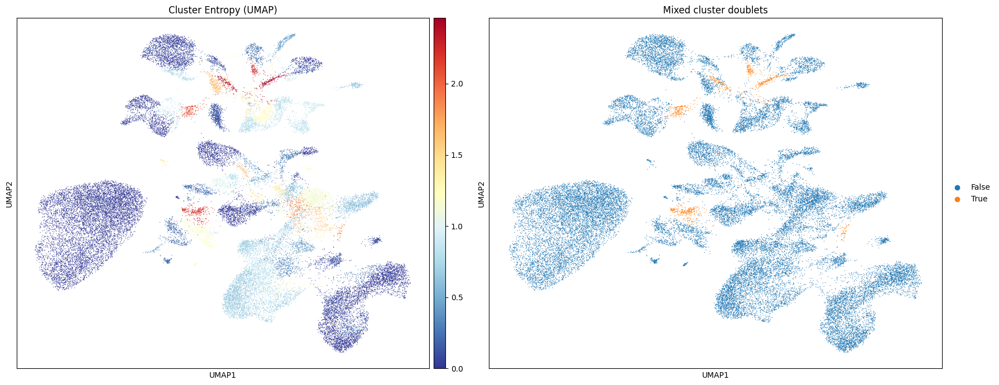

In [86]:
# Manually chosen
MIXED_CLUSTERS = ['60', '10', '100', '54', '87', '83']

#
adata.obs['cluster_entropy'] = adata.obs[cluster_level_for_mix].map(cluster_entropy)
adata.obs['is_mixed_cluster_doublet'] = adata.obs[cluster_level_for_mix].isin(MIXED_CLUSTERS)

print("\nDoublets distribution:")
print(adata.obs["is_mixed_cluster_doublet"].value_counts())
print("\nDoublets percentage:")
doublets_mix_pct = (
    adata.obs["is_mixed_cluster_doublet"]
    .value_counts(normalize=True)
    .loc[True]
)
print(doublets_mix_pct)

fig, axes = plt.subplots(1, 2, figsize=(18, 7))
sc.pl.umap(adata, color='cluster_entropy', ax=axes[0], show=False,
           cmap='RdYlBu_r', title='Cluster Entropy (UMAP)')
sc.pl.umap(adata, color='is_mixed_cluster_doublet', ax=axes[1], show=False,
           title='Mixed cluster doublets')
plt.tight_layout()
plt.show()

## Putative Doublets by gene Markers

Find gene makers (DEGs) for each cluster and see if they are ibtersection with makrher genes of a specific cell type.

If they overlap wiht more than 2 cell types they coudl be doublets.

In [ ]:
# # Find marker genes for each cluster (equivalent to FindAllMarkers)
#     # need log normlsied data --< NPY scaled
#     # DEG: cluster Vs rest
# sc.tl.rank_genes_groups(
#     adata, 
#     groupby=CLUSTER_LEVEL, 
#     method='wilcoxon', 
#     reference="rest", 
#     corr_method="benjamini-hochberg",
#     use_raw=False, 
#     layer="log1p_norm", #ATTNETION: NOT scaled data in X
#     pts = True, # ATTENTION; % cells expressing gene IN and OUT cluster 
# )

In [ ]:
# # Get top genes as DataFrame
# top_n = 300
# doublet_clusters_markers = {}

# for cluster in tqdm(adata.obs[CLUSTER_LEVEL].cat.categories):

#     # Get top genes for this cluster
#     df = sc.get.rank_genes_groups_df(adata, group=cluster) # sorted by score

#     df = df[
#         (df.pvals_adj < 0.05) &
#         (df.logfoldchanges > 1) &
#         (df.scores > 0) &
#         (df['pct_nz_group'] > 0.25) &  # only test genes that are detected in a minimum fraction  IN cluster
#         # (df['pct_nz_reference'] < 0.50) & # only test genes NOT expressed outside
#         # ((df['pct_nz_group'] - df['pct_nz_reference']) > 0.10) # Gene must be >10% more frequent in cluster than outside  
#     ] 


#     #display(df)
#     top_genes = set(df.head(top_n)['names'].tolist())
#     #print(top_genes)

#     # check if these top genes overlpa wiht one of the gene list of a specific cell type
#     cell_types_found = {}
#     for cell_type, cell_type_markers in translated_markers.items(): # ATTENTION: gene name
#         overlap = top_genes & set(cell_type_markers)
#         if len(overlap) != 0:
#             cell_types_found[cell_type] = list(overlap)

#     if len(cell_types_found.keys()) >= 2:
#         doublet_clusters_markers[cluster] = list(cell_types_found.keys())


# display(doublet_clusters_markers)


# fig, axes = plt.subplots(1, 2, figsize=(12, 5))
# for ax, g in zip(axes, [list(doublet_clusters_markers.keys()), 
#                     ['6', '7', '11', '12', '22', '29', '33', '34', '36', '48', '50', '52', '54', '55', '58']]# clusters with very differt cell types
#                     ): 
#     sc.pl.embedding(adata, basis="X_umap", color="leiden_4", legend_loc="on data",
#                     groups=g, ax=ax, show=False, return_fig=False)
# plt.tight_layout(); plt.show()




## Putative Doublets by Module score and Entropy

FOr each cell tyope marker genes lists, calculate the relative module socre (for each cell).

Calculate mean module score for each cluster for each module.

Claulte Entropy of these menas per cluster.

CLusters wiht high entropy (mix of modules) are doublets.

In [7]:
# import numpy as np
# from scipy.stats import entropy

# # Get all module score columns
# score_cols = [f'{ct}_score' for ct in markers.keys() if f'{ct}_score' in adata.obs]

# # Extract score matrix (cells × cell_types)
# score_matrix = adata.obs[score_cols].values

# # Shift to positive and normalize
# score_matrix = score_matrix - score_matrix.min(axis=1, keepdims=True) + 0.01
# score_matrix = score_matrix / score_matrix.sum(axis=1, keepdims=True)

# # Calculate entropy for each cell (vectorized)
# adata.obs['module_entropy'] = entropy(score_matrix.T)  # Transpose for scipy

# # Flag high-entropy cells as doublets
# threshold = np.percentile(adata.obs['module_entropy'], 85)  # Top 15%
# adata.obs['is_entropy_doublet'] = adata.obs['module_entropy'] > threshold

# # Results
# print(f"Entropy threshold: {threshold:.3f}")
# print(f"Entropy doublets: {adata.obs['is_entropy_doublet'].sum():,} ({adata.obs['is_entropy_doublet'].sum()/len(adata)*100:.1f}%)")

# # Visualize
# sc.pl.umap(adata, color=['module_entropy', 'is_entropy_doublet'], cmap='Reds', ncols=2)

In [ ]:
# # plot moduels per cluster
# # Get mean scores per cluster
# cluster_scores = adata.obs.groupby(CLUSTER_LEVEL, observed=False)[score_cols].mean()

# # Clean column names
# cluster_scores.columns = [c.replace('_score', '') for c in cluster_scores.columns]

# # Simple barplot - one per cluster
# n_clusters = len(cluster_scores)
# ncols = 6
# nrows = int(np.ceil(n_clusters / ncols))

# fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 3*nrows))
# axes = axes.flatten() if n_clusters > 1 else [axes]

# for idx, (cluster, row) in enumerate(cluster_scores.iterrows()):
#     ax = axes[idx]
    
#     # Sort values for easier reading
#     sorted_data = row.sort_values(ascending=True)
    
#     # Plot
#     ax.barh(range(len(sorted_data)), sorted_data.values, color='steelblue')
#     ax.set_yticks(range(len(sorted_data)))
#     ax.set_yticklabels(sorted_data.index, fontsize=8)
#     ax.set_xlabel('Mean Module Score', fontsize=9)
#     ax.set_title(f'Cluster {cluster}', fontweight='bold')
#     ax.axvline(0, color='black', linestyle='--', linewidth=0.8)
#     ax.grid(axis='x', alpha=0.3)
#     ax.set_xlim((-0.2, 1))
#     ax.axvline(0.4, linestyle='--', linewidth=1, color="red")

# # Hide empty subplots
# for idx in range(n_clusters, len(axes)):
#     axes[idx].axis('off')

# plt.tight_layout()
# plt.show()

In [ ]:
# from scipy.stats import entropy

# # Calculate entropy for each cluster (higher = more mixed)
# cluster_scores_entropy = cluster_scores.copy()
# cluster_scores_entropy['entropy'] = cluster_scores.apply(
#     lambda x: entropy(x[x > 0] / x[x > 0].sum()) if (x > 0).sum() > 1 else 0,  # clauclte onyl for vlaues bogger than 0
#     axis=1
# )

# # Flag top 25% as potential doublets
# threshold = cluster_scores_entropy['entropy'].quantile(0.75)
# high_entropy_clusters = cluster_scores_entropy[cluster_scores_entropy['entropy'] > threshold]

# # Plot
# cluster_scores_entropy['entropy'].sort_values(ascending=False).plot(
#     kind='bar', figsize=(12, 5), color='steelblue', title='Cluster Entropy'
# )
# plt.axhline(threshold, color='red', linestyle='--', label=f'Threshold: {threshold:.2f}')
# plt.ylabel('Entropy (higher = doublet)')
# plt.legend()
# plt.tight_layout()
# plt.show()

# # Create doublet dictionary: cluster -> cell types with high scores
# doublet_clusters_entropy = {}
# for cluster in high_entropy_clusters.index:
#     scores = cluster_scores_entropy.loc[cluster].drop('entropy')
#     # Get cell types with scores > 0.3
#     threshold = scores.quantile(0.75) 
#     active_types = scores[scores > threshold].sort_values(ascending=False)
#     if len(active_types) >= 2:
#         doublet_clusters_entropy[cluster] = active_types.index.tolist()

# # Display results
# print("Entropy-based doublet clusters:")
# display(doublet_clusters_entropy)

# # Plot
# fig, axes = plt.subplots(1, 2, figsize=(12, 5))
# for ax, clusters in zip(axes, [list(doublet_clusters_entropy.keys()), 
#                                ['3', '5', '11', '12', '15', '19', '22', '32', '33', '45', '49', '52', '54', '55', '58']]):
#     sc.pl.embedding(adata, basis="X_umap", color="leiden_4", legend_loc="on data",
#                     groups=clusters, ax=ax, show=False)
# plt.tight_layout()
# plt.show()

## Putative Doublets by Oligo Module score

In [80]:
score_col_oligo = "Oligodendrocyte_score"
cluster_col = "leiden_2" # need broad clustering
P_VALUE_THRESHOLD = 0.05

In [ ]:
# # get cluster names
# clusters = adata.obs[cluster_col].sort_values().unique()
# results = []

# # Setup plot grid
# ncols = 6
# nrows = int(np.ceil(len(clusters) / ncols))
# fig, axes = plt.subplots(nrows, ncols, figsize=(3*ncols, 15))
# axes = axes.flatten()

# # Analyze each cluster
# for idx, cluster in enumerate(clusters):

#     # Get score for this cluster
#     scores = adata.obs.loc[adata.obs[cluster_col] == cluster, score_col_oligo].values
    
#     # Statistical test for bimodality
#     _, p_value = diptest(scores) #(H₀): The distribution is unimodal (one peak)
#     is_bimodal = p_value < P_VALUE_THRESHOLD
    
#     # Fit Gaussian mixture for visualization
#     gmm = GaussianMixture(n_components=2, random_state=42).fit(scores.reshape(-1, 1))
    
#     # Plot: score distribution, fitted gassians, and retrun valley point
#     threshold = preprocessing.plot_cluster_and_get_valley(axes[idx], scores, cluster, gmm, is_bimodal, p_value, score_col_oligo)
    
#     # Store results
#     results.append({
#         'Cluster': cluster,
#         'P_Value': p_value,
#         'Is_Bimodal': is_bimodal,
#         'Threshold': threshold
#     })

# # Clean up empty subplots
# for idx in range(len(clusters), len(axes)):
#     fig.delaxes(axes[idx])

# plt.tight_layout()
# plt.show()

# # Print summary
# results_df = pd.DataFrame(results).sort_values('P_Value')
# display(results_df.head(10))

# thresholds_dict = results_df.set_index('Cluster')['Threshold'].to_dict()
# print(thresholds_dict)

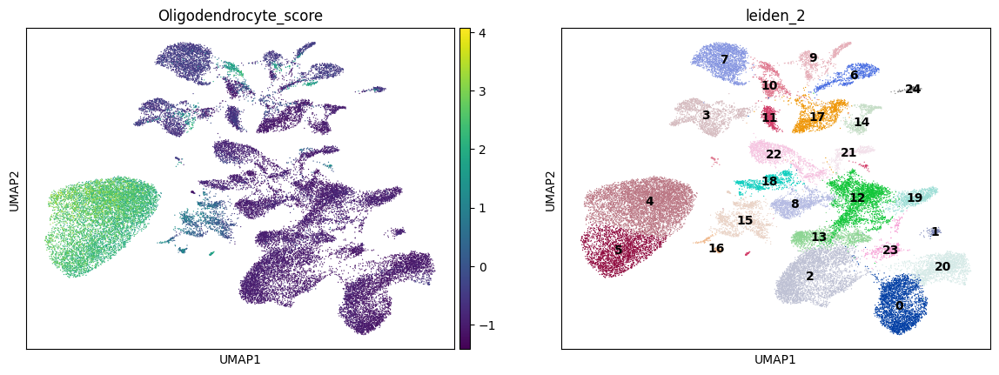

In [81]:
# Define clusters wiht real oligos
sc.pl.umap(adata, color=[score_col_oligo, cluster_col], gene_symbols="gene_symbol", ncols=2, legend_loc="on data")

REAL_OLIGO_CLUSTERS = ["4", "5"]# ["8", "10", "11", "12"] #["4", "5"]

Mean thr:  0

Doublets distribution:
is_oligo_doublet
False    33812
True      1764
Name: count, dtype: int64

Doublets percentage:
0.04958398920620643


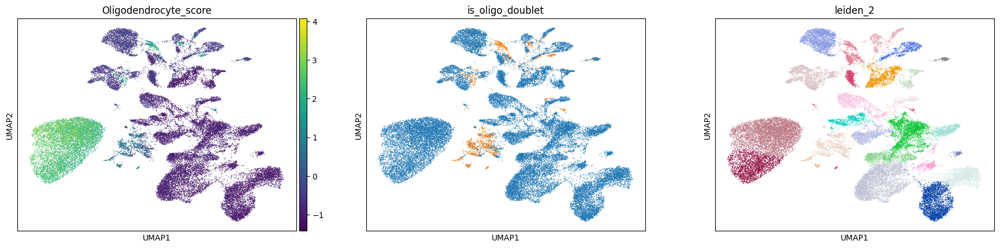

In [82]:
# define doublets by oligo score
    # 1) they are not real oligos (not in REAL_OLIGO_CLUSTERS)
    # 2) their oligo score is above the threshold 
        # defined for their cluster ?
        # mean of all thresholds --> OK

# if want to use mean thr
#mean_threshold = results_df[(results_df['Is_Bimodal']) & (~results_df["Cluster"].isin(REAL_OLIGO_CLUSTERS))]['Threshold'].mean()

# if want to use constant one
mean_threshold = 0 #results_df[(results_df['Is_Bimodal']) & (~results_df["Cluster"].isin(REAL_OLIGO_CLUSTERS))]['Threshold'].mean()

print("Mean thr: ", mean_threshold)

adata.obs["is_oligo_doublet"] = [
    (adata.obs.loc[cell, score_col_oligo] >= mean_threshold)
    and (adata.obs.loc[cell, cluster_col] not in REAL_OLIGO_CLUSTERS)
    for cell in adata.obs_names
]

# if we want to use cluster-specific thresholds
# adata.obs['cluster_threshold'] = adata.obs[cluster_col].map(thresholds_dict)
# adata.obs["is_oligo_doublet"] = (
#     ~adata.obs[cluster_col].isin(REAL_OLIGO_CLUSTERS) &  # NOT real oligo
#     (adata.obs[score_col_oligo] >= adata.obs['cluster_threshold'])  # Above CLUSTER-SPECIFIC threshold
# )

print("\nDoublets distribution:")
print(adata.obs["is_oligo_doublet"].value_counts())
print("\nDoublets percentage:")
doublets_oligo_pct = (
    adata.obs["is_oligo_doublet"]
    .value_counts(normalize=True)
    .loc[True]
)
print(doublets_oligo_pct)

sc.pl.umap(adata, color=[score_col_oligo, 'is_oligo_doublet', cluster_col], gene_symbols="gene_symbol", ncols=3, legend_loc=None)


In [87]:
# Goal: find a good doblet rate estimation to give to scorublet

# reconsctct total doublets rate
    #p_oligo = proportion of oligos in your sample
p_oligo = (adata.obs.Subclass_name == "Oligodendrocyte").sum() / len(adata)
print(f"Proportion of Oligos: {p_oligo:.3f}")
predicted_total_doublet_rate_by_oligo = doublets_oligo_pct / (2 * p_oligo * (1 - p_oligo))
     # ATTENTION: it doesnt takes into account homotopyc doublets

print(predicted_total_doublet_rate_by_oligo)

Proportion of Oligos: 0.242
0.13513619540145064


## Putative Doublets by Scrublet

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.27
Detected doublet rate = 10.1%
Estimated detectable doublet fraction = 63.0%
Overall doublet rate:
	Expected   = 13.5%
	Estimated  = 16.1%
Elapsed time: 169.0 seconds


(<Figure size 800x300 with 2 Axes>,
 array([<Axes: title={'center': 'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <Axes: title={'center': 'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

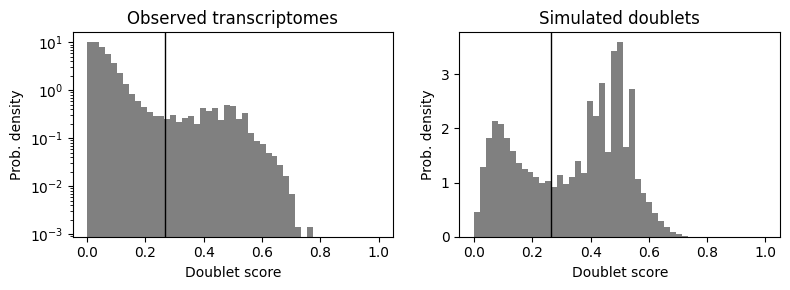

In [88]:
import scrublet as scr

counts = adata.layers['counts'].copy()

scrub = scr.Scrublet(
    counts,
    expected_doublet_rate=predicted_total_doublet_rate_by_oligo,  # Use prior estimate 
    sim_doublet_ratio=2
)

doublet_scores, predicted_doublets = scrub.scrub_doublets(
    min_counts=2,
    min_cells=3,
    min_gene_variability_pctl=85,
    n_prin_comps=30
)

# if you want spefic thr
# THR_SCRUBLET = 0.27  # set based on histogram inspection
# scrub.call_doublets(threshold=THR_SCRUBLET, verbose=False)
# predicted_doublets = scrub.predicted_doublets_

# Plot to find natural separation
scrub.plot_histogram()


0.10147290308072858


<Axes: title={'center': 'Scrublet doublets (10.1%)'}, xlabel='UMAP1', ylabel='UMAP2'>

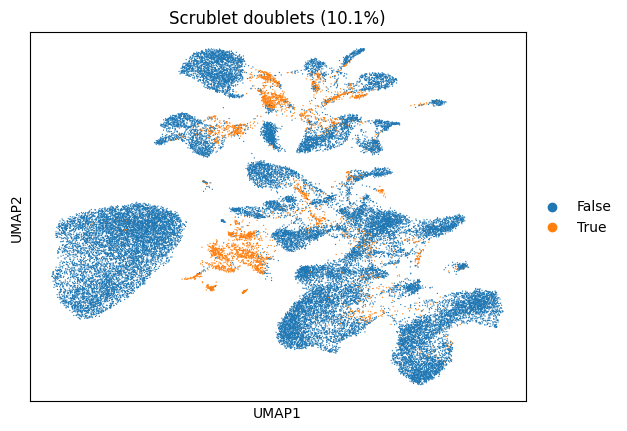

In [90]:
# store in adata
adata.obs['scrublet_score'] = doublet_scores
adata.obs['is_scrublet_doublet'] = predicted_doublets

# calculate
total_doublet_rate_by_scrublet = predicted_doublets.sum() / len(predicted_doublets)
print(total_doublet_rate_by_scrublet)

# Plot overlap
# sc.pl.umap(adata, color='is_oligo_doublet', show=False, 
#            title=f'Oligo doublets ({predicted_total_doublet_rate_by_oligo*100:.1f}%)')
sc.pl.umap(adata, color='is_scrublet_doublet', show=False,
           title=f'Scrublet doublets ({total_doublet_rate_by_scrublet*100:.1f}%)')

## Filter

In [91]:
# for this case we use only is oligo_doublet
adata.obs["is_doublet"] = adata.obs["is_mixed_cluster_doublet"] |adata.obs["is_oligo_doublet"] | adata.obs["is_scrublet_doublet"]

print("\nDoublets distribution:")
print(adata.obs["is_doublet"].value_counts())
print("\nDoublets percentage:")
print(adata.obs["is_doublet"].value_counts().div(len(adata)))


Doublets distribution:
is_doublet
False    31606
True      3970
Name: count, dtype: int64

Doublets percentage:
is_doublet
False    0.888408
True     0.111592
Name: count, dtype: float64


In [92]:
print(adata)
adata = adata[~adata.obs["is_doublet"]].copy()
print(adata)

adata.write(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/doublets_filtered_adata.h5ad')
del(adata)

AnnData object with n_obs × n_vars = 35576 × 34115
    obs: 'x', 'y', 'pct_intronic', 'is_cell', 'dbscan_clusters', 'dbscan_score', 'has_spatial', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_1

In [93]:
adata = sc.read_h5ad(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/doublets_filtered_adata.h5ad')
adata

AnnData object with n_obs × n_vars = 31606 × 34115
    obs: 'x', 'y', 'pct_intronic', 'is_cell', 'dbscan_clusters', 'dbscan_score', 'has_spatial', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_1

# Reprocess Clean Data

Normalizing...
Findingn HCGs...


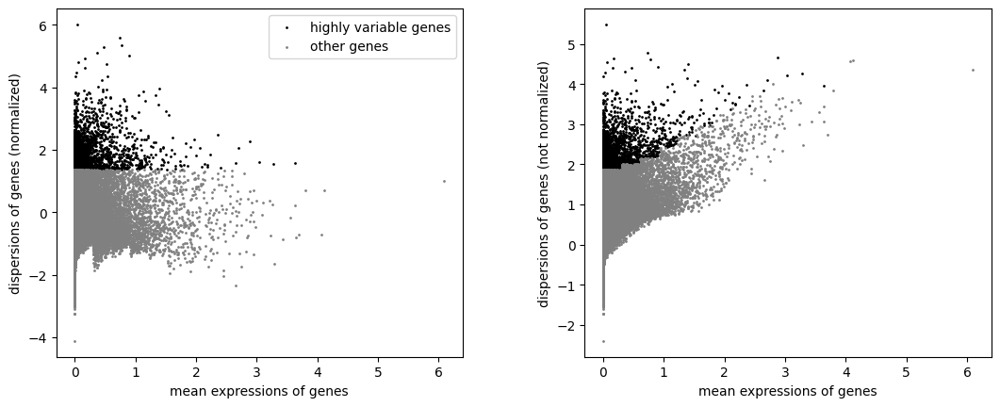

Scaling...


/home/gdallagl/.pyenv/versions/3.11.8/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


Calculating PCA...


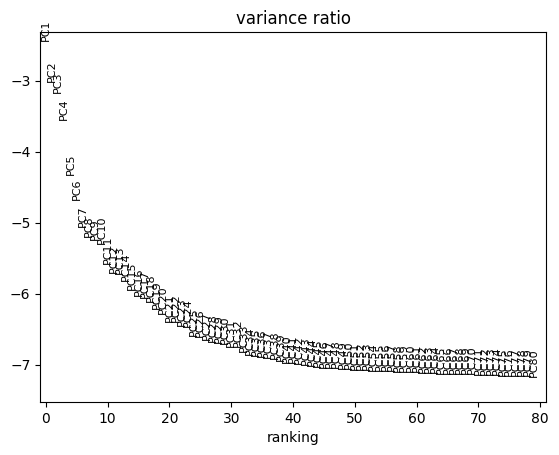

Calculating neightbors...
Calculating Umap...
Clutering...


In [100]:
# ATTENTION: bring bacj count
adata.X = adata.layers["counts"].copy()

# recalutle qc metrics (ex count_per_cell)
adata.var["mt"] = adata.var.gene_symbol.str.startswith("MT-") # mitochondrial genes, ATTNETION: the names are in "gene_symbol"
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], inplace=True)

preprocessing.preprocess(adata, n_pcs_elbow=30, n_hvg=3000)

# Add specific cell type hierarchy

In [104]:
GROUP_NAME_TO_BROAD_CATEGORY = {
    
    # ============================================================
    # SPINY PROJECTION NEURONS (SPNs)
    # ============================================================
    
    # ---- Matrix SPNs ----
    'STRd D1 Matrix MSN': 'Matrix SPN',
    'STRd D2 Matrix MSN': 'Matrix SPN',
    'STRv D1 MSN':        'Matrix SPN',
    'STRv D2 MSN':        'Matrix SPN',
    
    # ---- Striosome SPNs ----
    'STRd D1 Striosome MSN': 'Striosome SPN',
    'STRd D2 Striosome MSN': 'Striosome SPN',
    
    # ---- Hybrid / Transitional SPNs ---- exttrinsic ST --> non canonical  neurons
    'STRv D1 NUDAP MSN':        'Hybrid SPN',
    'STR D1D2 Hybrid MSN':      'Hybrid SPN',
    'STRd D2 StrioMat Hybrid MSN': 'Hybrid SPN',
    
    
    # ============================================================
    # STRIATAL INTERNEURONS
    # ============================================================
    
    # ---- SST Interneurons ----
    'STR SST-CHODL GABA':  'STR Interneuron',
    'STR SST-RSPO2 GABA':  'STR Interneuron',
    'STR SST-ADARB2 GABA': 'STR Interneuron',
    
    # ---- PV / Fast-Spiking Interneurons ----
    'STR FS PTHLH-PVALB GABA': 'STR Interneuron (PV)',
    
    # ---- Other GABAergic Interneurons ----
    'STR TAC3-PLPP4 GABA':        'STR Interneuron',
    'STR LYPD6-RSPO2 GABA':       'STR Interneuron',
    'STR-BF TAC3-PLPP4-LHX8 GABA': 'STR Interneuron',
    
    # ---- Cholinergic Interneurons ----
    'STRd Cholinergic GABA': 'STR Interneuron (Cholinergic)',
    'STR Cholinergic GABA':  'STR Interneuron (Cholinergic)',
    
    
    # ============================================================
    # GLOBUS PALLIDUS
    # ============================================================
    
    # ---- GPe ----
    'GPe-NDB-SI LHX6-LHX8-GBX1 GABA': 'GPe Neuron',
    'GPe MEIS2-SOX6 GABA':            'GPe Neuron',
    'GPe SOX6-CTXND1 GABA':           'GPe Neuron',
    
    # ---- GPi ----
    'GPin-BF Cholinergic GABA': 'GPi Neuron',
}

GROUP_NAME_TO_BROAD_CATEGORY_ALL = {
    # --- SPN / MSN subclasses ---
    'STRv D1 NUDAP MSN': 'SPN',
    'OT D1 ICj': 'SPN',
    'STRd D2 Striosome MSN': 'SPN',
    'STRv D2 MSN': 'SPN',
    'STRv D1 MSN': 'SPN',
    'STRd D1 Striosome MSN': 'SPN',
    'STR D1D2 Hybrid MSN': 'SPN',
    'STRd D1 Matrix MSN': 'SPN',
    'STRd D2 Matrix MSN': 'SPN',
    'STRd D2 StrioMat Hybrid MSN': 'SPN',
    'AMY-SLEA-BNST D1 GABA': 'SPN',   # D1-type projection neurons in extended amygdala

    # --- Astrocyte ---
    'Astrocyte': 'astrocyte',
    'ImAstro': 'astrocyte',

    # --- Oligodendrocyte lineage ---
    'Oligo OPALIN': 'oligo',
    'Oligo PLEKHG1': 'oligo',
    'COP': 'oligo',    # committed oligodendrocyte precursor
    'OPC': 'opc',

    # --- Microglia / immune ---
    'Microglia': 'microglia',
    'T cells': 'immune',
    'BAM': 'immune',  # border-associated macrophage

    # --- Endothelial / vascular-related ---
    'Endo': 'endo',
    'Pericyte': 'endo',
    'VLMC': 'endo',
    'SMC': 'endo',    # smooth muscle cell
    'Ependymal': 'endo',  # glial/ependymal but closest allowed category

    # --- Non-SPN neurons (interneurons & all others) ---
    'STR TAC3-PLPP4 GABA': 'non-SPN neuron',
    'OB FRMD7 GABA': 'non-SPN neuron',
    'AMY-SLEA-BNST GABA': 'non-SPN neuron',
    'VIP GABA': 'non-SPN neuron',
    'LAMP5-CXCL14 GABA': 'non-SPN neuron',
    'GPin-BF Cholinergic GABA': 'non-SPN neuron',
    'VTR-HTH Glut': 'non-SPN neuron',
    'LAMP5-LHX6 GABA': 'non-SPN neuron',
    'STR SST-CHODL GABA': 'non-SPN neuron',
    'STR SST-RSPO2 GABA': 'non-SPN neuron',
    'STR FS PTHLH-PVALB GABA': 'non-SPN neuron',
    'ZI-HTH GABA': 'non-SPN neuron',
    'STR LYPD6-RSPO2 GABA': 'non-SPN neuron',
    'STR-BF TAC3-PLPP4-LHX8 GABA': 'non-SPN neuron',
    'STR SST-ADARB2 GABA': 'non-SPN neuron',
    'GPe-NDB-SI LHX6-LHX8-GBX1 GABA': 'non-SPN neuron',
    'BF SKOR1 Glut': 'non-SPN neuron',
    'GPe SOX6-CTXND1 GABA': 'non-SPN neuron',
    'SN EBF2 GABA': 'non-SPN neuron',
    'STRd Cholinergic GABA': 'non-SPN neuron',
    'GPe MEIS2-SOX6 GABA': 'non-SPN neuron',
    'OB Dopa-GABA': 'non-SPN neuron',
    'SN-VTR-HTH GATA3-TCF7L2 GABA': 'non-SPN neuron',
    'STR Cholinergic GABA': 'non-SPN neuron',
}


adata.obs['my_hierarchy'] = adata.obs['Group_name'].map(GROUP_NAME_TO_BROAD_CATEGORY)#.fillna('Other')
adata.obs['my_hierarchy_all'] = adata.obs['Group_name'].map(GROUP_NAME_TO_BROAD_CATEGORY_ALL)#.fillna('Other')

# Save adata

In [105]:
adata.write(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/reprocessed_filtered_adata.h5ad')
del(adata)


In [106]:
adata = sc.read_h5ad(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/reprocessed_filtered_adata.h5ad')
adata

AnnData object with n_obs × n_vars = 31606 × 34115
    obs: 'x', 'y', 'pct_intronic', 'is_cell', 'dbscan_clusters', 'dbscan_score', 'has_spatial', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_1

# Metric by cluster

/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"{value_to_plot}_colors"] = colors_list


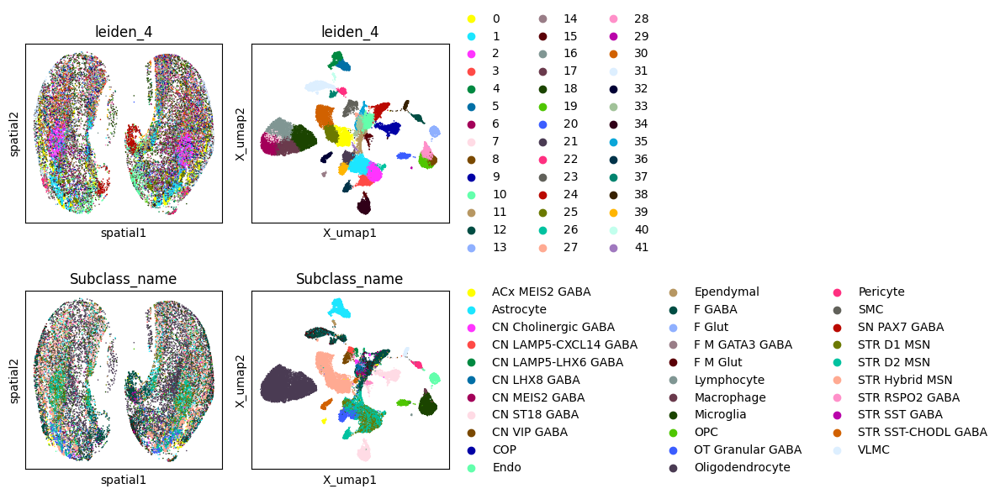

In [107]:
# Select level to investigaet
CLUSTER_LEVEL = "leiden_4"
ANNOTATION_LEVEL = "Subclass_name"

fig, axes = plt.subplots(2, 2, figsize=(12,6))

adata_spatial = ad.AnnData(X=csr_matrix(adata.X.shape),obs=adata.obs.copy(),var=adata.var.copy(),uns=adata.uns.copy(),obsm=adata.obsm.copy())
adata_spatial = adata_spatial[adata_spatial.obs.has_spatial]

for i, res in enumerate([CLUSTER_LEVEL, ANNOTATION_LEVEL]):
    sc.pl.embedding(adata_spatial, basis="spatial", color=res, ax=axes[i,0], show=False, size=5, legend_loc=None)
    sc.pl.embedding(adata, basis="X_umap", color=res, ax=axes[i,1], show=False, legend_fontsize=10, size=5)# legend_loc="on data",)# legend_loc="lower center")

plt.tight_layout()
plt.show()

## Leiden clusters

/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"{value_to_plot}_colors"] = colors_list


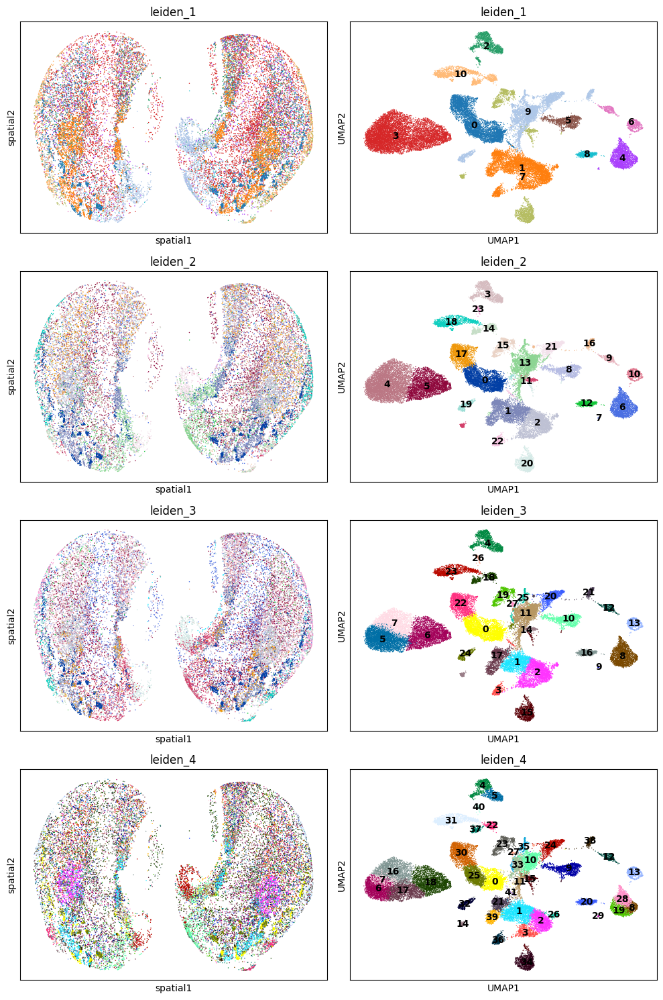

In [108]:
fig, axes = plt.subplots(4, 2, figsize=(10, 15))

adata_spatial = ad.AnnData(X=csr_matrix(adata.X.shape),obs=adata.obs.copy(),var=adata.var.copy(),uns=adata.uns.copy(),obsm=adata.obsm.copy())
adata_spatial = adata_spatial[adata_spatial.obs.has_spatial]

for i, res in enumerate(["leiden_1", "leiden_2", "leiden_3", "leiden_4"]):
    sc.pl.embedding(adata_spatial, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_loc="on data")

plt.tight_layout()
plt.show()

## UMI counts distribution by cluster

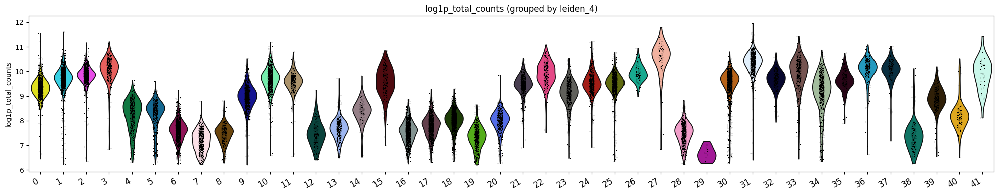

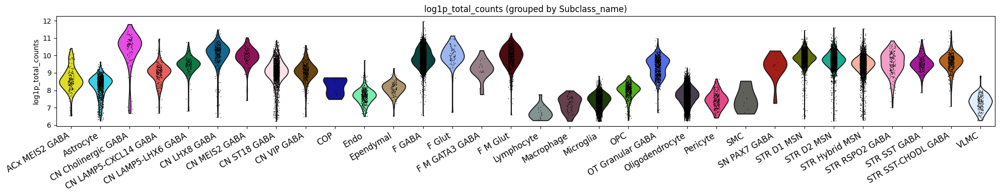

In [109]:
metrics = [
    "log1p_total_counts",
    # "n_genes_by_counts",
    # "pct_intronic",
    # "pct_counts_mt",
    # "Class_bootstrapping_probability"
]

#############################
# FIGURE 1 — grouped by CLUSTER_LEVEL
#############################
fig1, axes1 = plt.subplots(
    nrows=len(metrics),
    ncols=1,
    figsize=(20, 4 * len(metrics))
)
if len(metrics) == 1:
    axes1 = [axes1]

for i, key in enumerate(metrics):
    sc.pl.violin(
        adata,
        keys=key,
        groupby=CLUSTER_LEVEL,
        rotation=30,
        ax=axes1[i],
        show=False
    )
    axes1[i].set_title(f"{key} (grouped by {CLUSTER_LEVEL})")
    for label in axes1[i].get_xticklabels():
        label.set_horizontalalignment("right")
        label.set_fontsize(12)

plt.tight_layout()
plt.show()


#############################
# FIGURE 2 — grouped by ANNOTATION_LEVEL
#############################
fig2, axes2 = plt.subplots(
    nrows=len(metrics),
    ncols=1,
    figsize=(20, 4 * len(metrics))
)
if len(metrics) == 1:
    axes2 = [axes2]

for i, key in enumerate(metrics):
    sc.pl.violin(
        adata,
        keys=key,
        groupby=ANNOTATION_LEVEL,
        rotation=30,
        ax=axes2[i],
        show=False
    )
    axes2[i].set_title(f"{key} (grouped by {ANNOTATION_LEVEL})")
    for label in axes2[i].get_xticklabels():
        label.set_horizontalalignment("right")
        label.set_fontsize(12)


plt.tight_layout()
plt.show()


In [35]:
# HSIT DITRCIBTUON COUNT PER CLUSTER

# # Get unique clusters
# clusters = adata.obs[CLUSTER_LEVEL].unique()

# n_clusters = len(clusters)
# ncols = 5
# nrows = int(np.ceil(n_clusters / ncols))

# fig, axes = plt.subplots(nrows, ncols, figsize=(20, 3*nrows))
# axes = axes.flatten()

# for idx, cluster in enumerate(clusters):
#     ax = axes[idx]
    
#     # Get data for this cluster
#     cluster_data = adata.obs[adata.obs[CLUSTER_LEVEL] == cluster]['total_counts']
    
#     # Plot histogram
#     ax.hist(cluster_data, bins=30, color='steelblue', alpha=0.7, edgecolor='black')
#     ax.set_title(f'Cluster {cluster}', fontweight='bold')
#     ax.set_xlabel('Total Counts')
#     ax.set_ylabel('# Cells')
    
#     # Add mean line
#     mean_val = cluster_data.mean()
#     ax.axvline(mean_val, color='red', linestyle='--', linewidth=2, 
#                label=f'Mean: {mean_val:.0f}')
    
#     # Same x-axis for all
#     #ax.set_xlim(global_min, global_max)
#     ax.legend(fontsize=8)
#     ax.grid(alpha=0.3)

# # Hide unused subplots
# for idx in range(n_clusters, len(axes)):
#     axes[idx].axis('off')

# plt.suptitle('Total Counts Distribution per Cluster', fontsize=16, fontweight='bold')
# plt.tight_layout()
# plt.show()

## Cell Type distribution on Umap/spatial

/home/gdallagl/myworkdir/XDP/utils/preprocessing.py:206: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_spatial.obs["temp_highlight"] = adata_spatial.obs[ANNOTATION_LEVEL].apply(


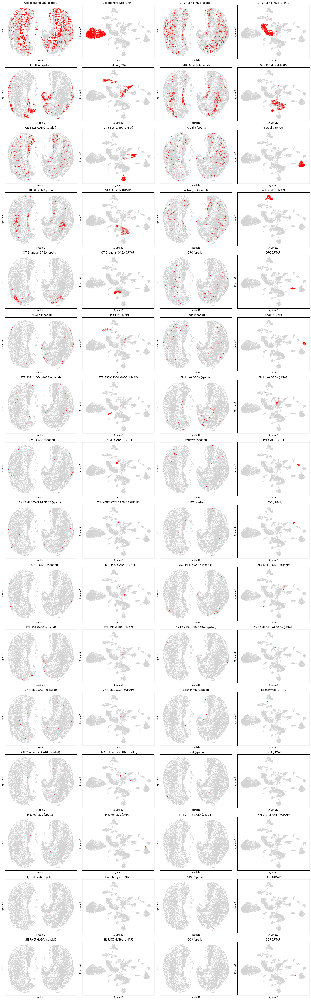

In [110]:
adata_spatial = ad.AnnData(X=csr_matrix(adata.X.shape),obs=adata.obs.copy(),var=adata.var.copy(),uns=adata.uns.copy(),obsm=adata.obsm.copy())
adata_spatial = adata_spatial[adata_spatial.obs.has_spatial]

preprocessing.plot_cell_type(adata, adata_spatial, ANNOTATION_LEVEL=ANNOTATION_LEVEL)

/home/gdallagl/myworkdir/XDP/utils/preprocessing.py:206: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_spatial.obs["temp_highlight"] = adata_spatial.obs[ANNOTATION_LEVEL].apply(


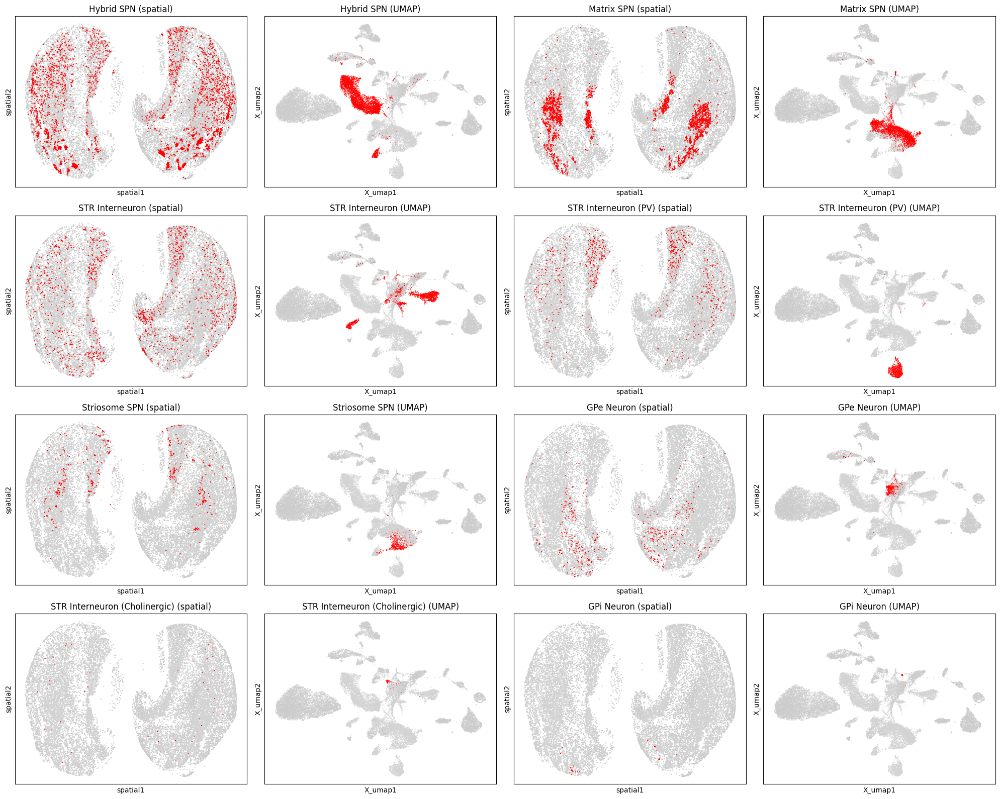

In [111]:
adata_spatial = ad.AnnData(X=csr_matrix(adata.X.shape),obs=adata.obs.copy(),var=adata.var.copy(),uns=adata.uns.copy(),obsm=adata.obsm.copy())
adata_spatial = adata_spatial[adata_spatial.obs.has_spatial]

preprocessing.plot_cell_type(adata, adata_spatial, ANNOTATION_LEVEL="my_hierarchy")

## Overall cell type distribution

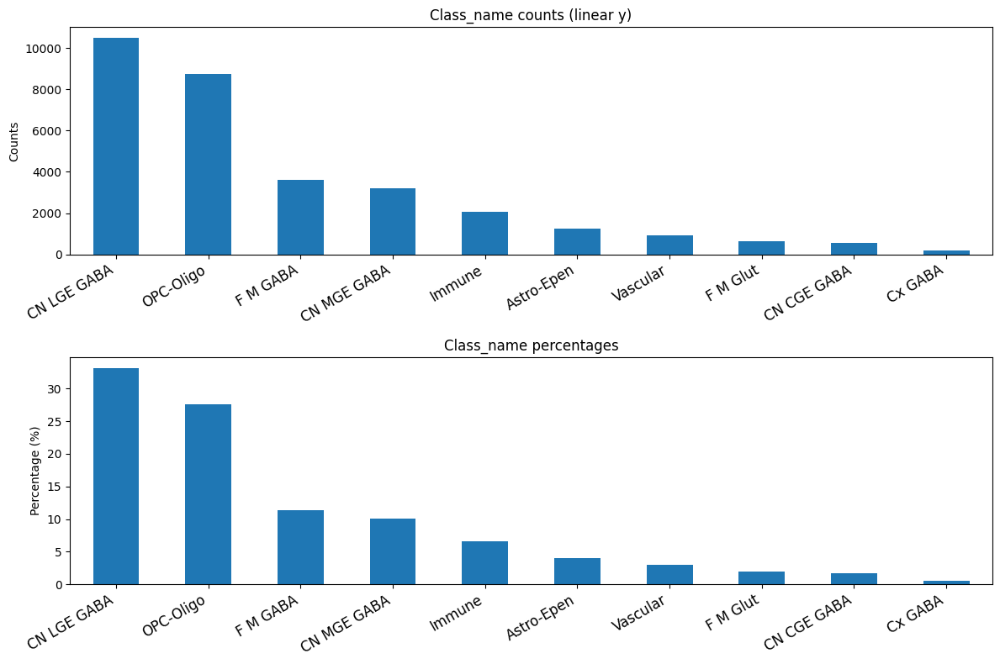

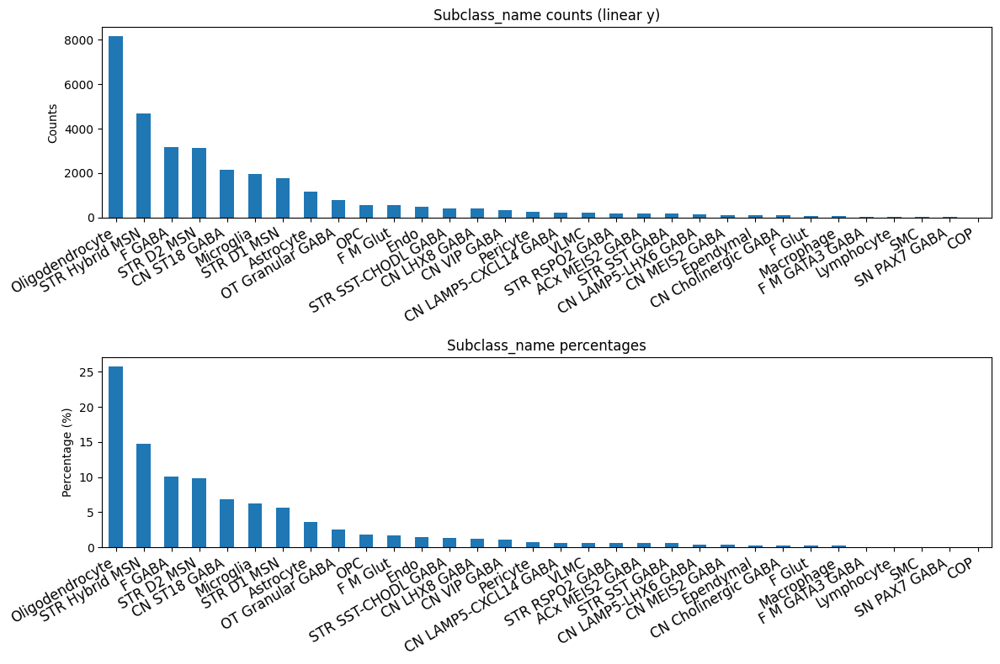

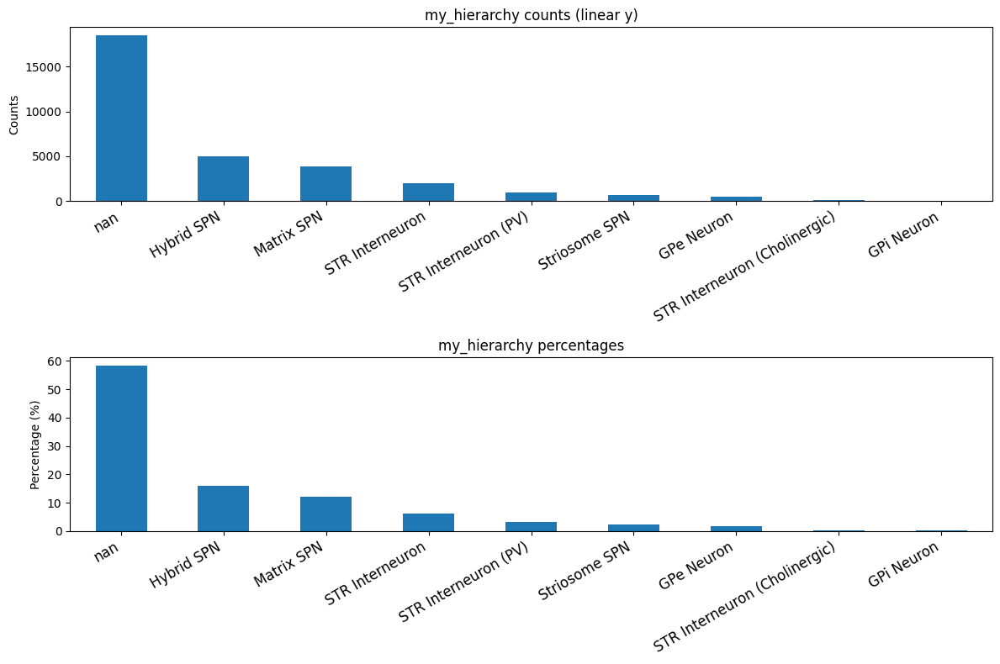

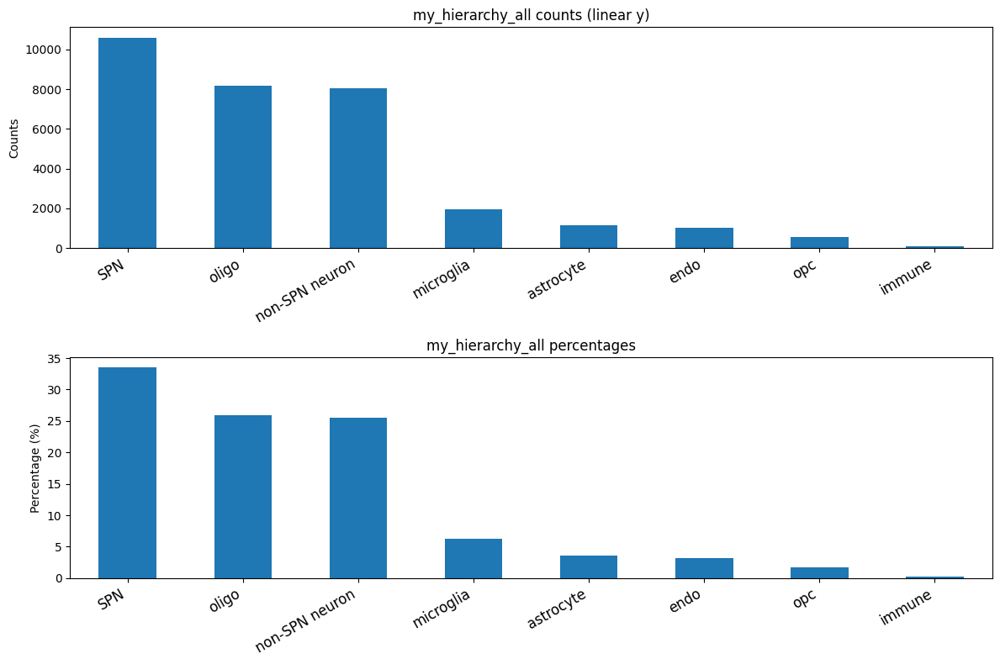

In [112]:
preprocessing.plot_cell_type_distribution(adata, annotation_levels=["Class_name", "Subclass_name", "my_hierarchy", "my_hierarchy_all"])

## Cell Type distribution by cluster

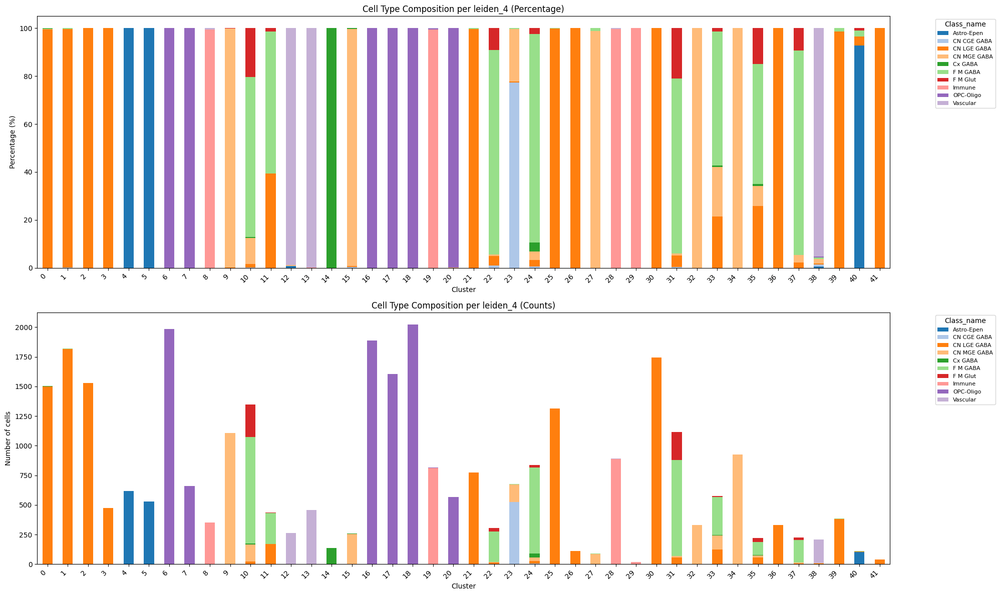

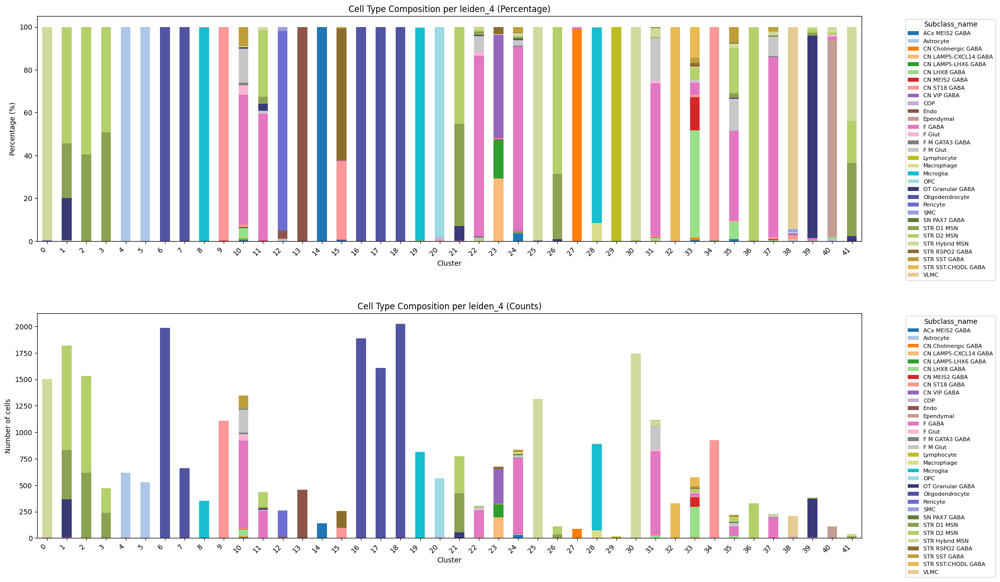

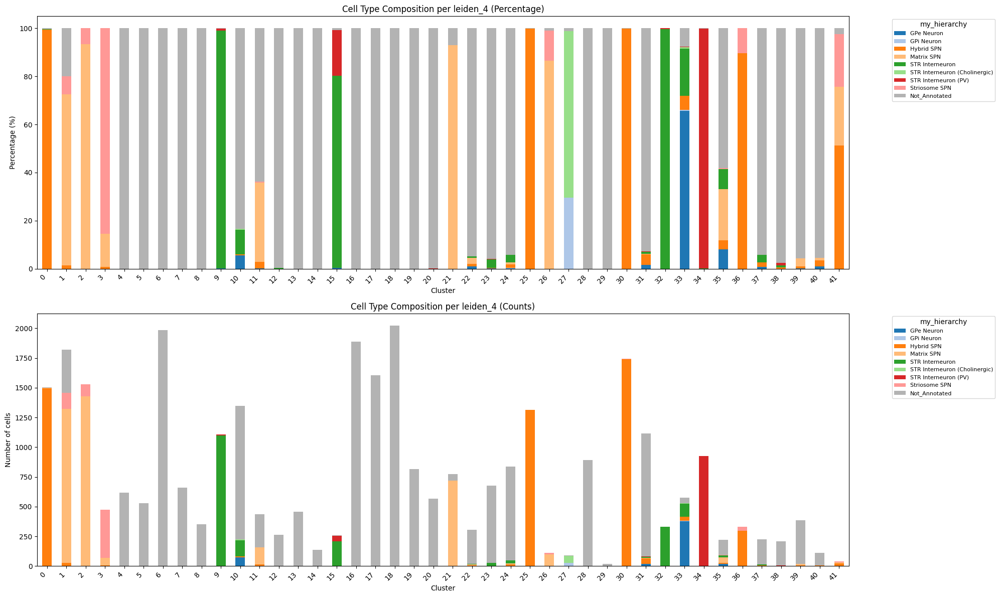

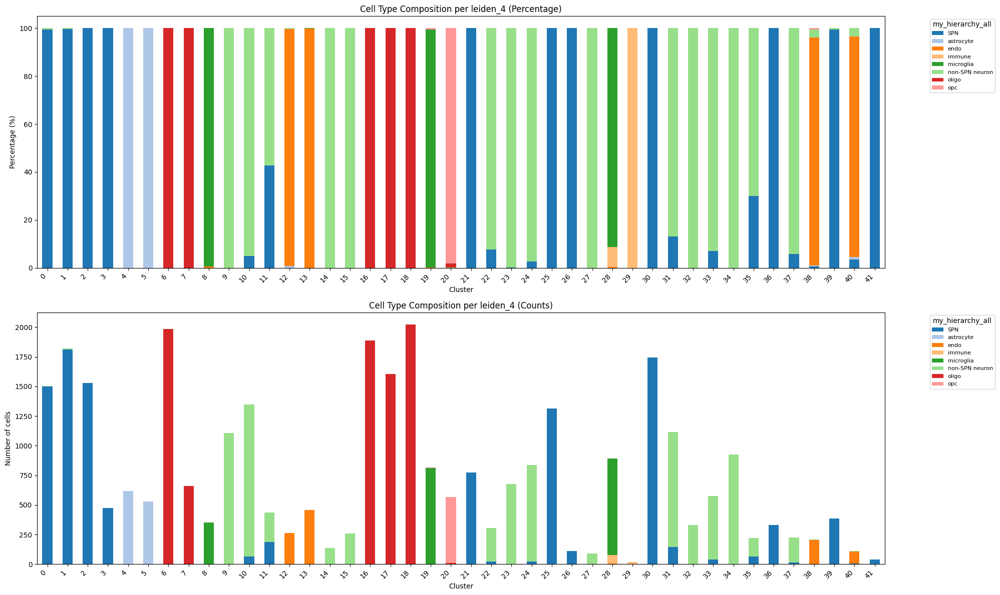

In [113]:
preprocessing.plot_cell_type_distribution_per_cluster(adata, ANNOTATION_LEVEL="Class_name", CLUSTER_LEVEL=CLUSTER_LEVEL)
preprocessing.plot_cell_type_distribution_per_cluster(adata, ANNOTATION_LEVEL="Subclass_name", CLUSTER_LEVEL=CLUSTER_LEVEL)
preprocessing.plot_cell_type_distribution_per_cluster(adata, ANNOTATION_LEVEL="my_hierarchy", CLUSTER_LEVEL=CLUSTER_LEVEL)
preprocessing.plot_cell_type_distribution_per_cluster(adata, ANNOTATION_LEVEL="my_hierarchy_all", CLUSTER_LEVEL=CLUSTER_LEVEL)

## MapMyCell cell types

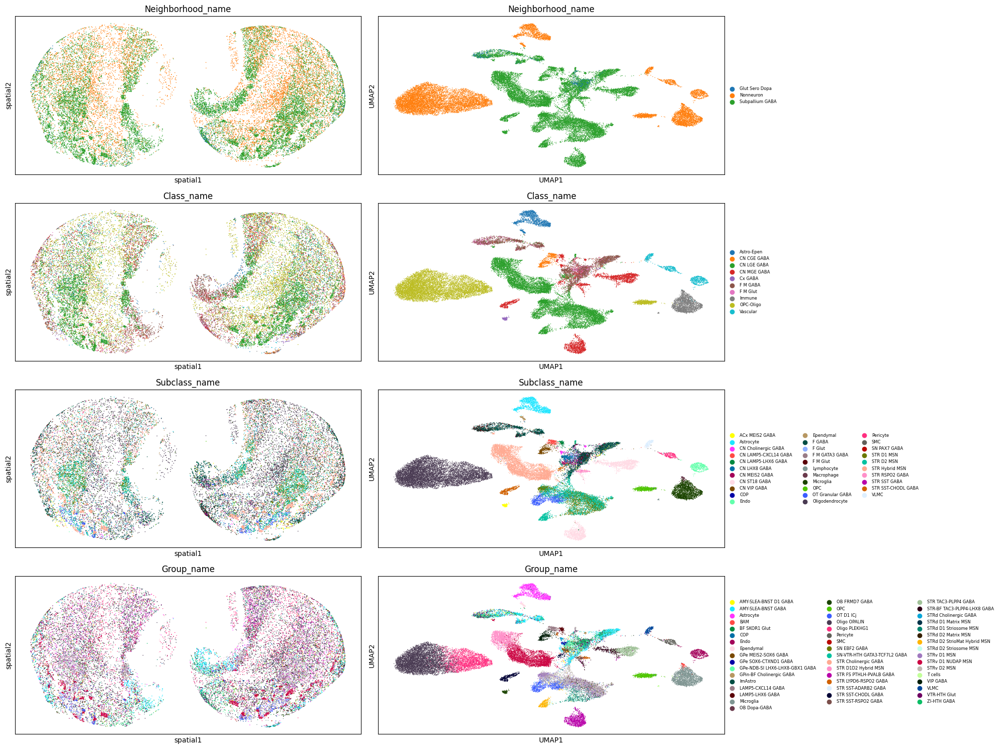

In [114]:
fig, axes = plt.subplots(4, 2, figsize=(20, 15))

adata_spatial = ad.AnnData(X=csr_matrix(adata.X.shape),obs=adata.obs.copy(),var=adata.var.copy(),uns=adata.uns.copy(),obsm=adata.obsm.copy())
adata_spatial = adata_spatial[adata_spatial.obs.has_spatial]

for i, res in enumerate(["Neighborhood_name", "Class_name", "Subclass_name", "Group_name"]):
    sc.pl.embedding(adata_spatial, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_fontsize=6)# legend_loc="lower center")

plt.tight_layout()
plt.show()

## Artificial Hierarchy

/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"{value_to_plot}_colors"] = colors_list


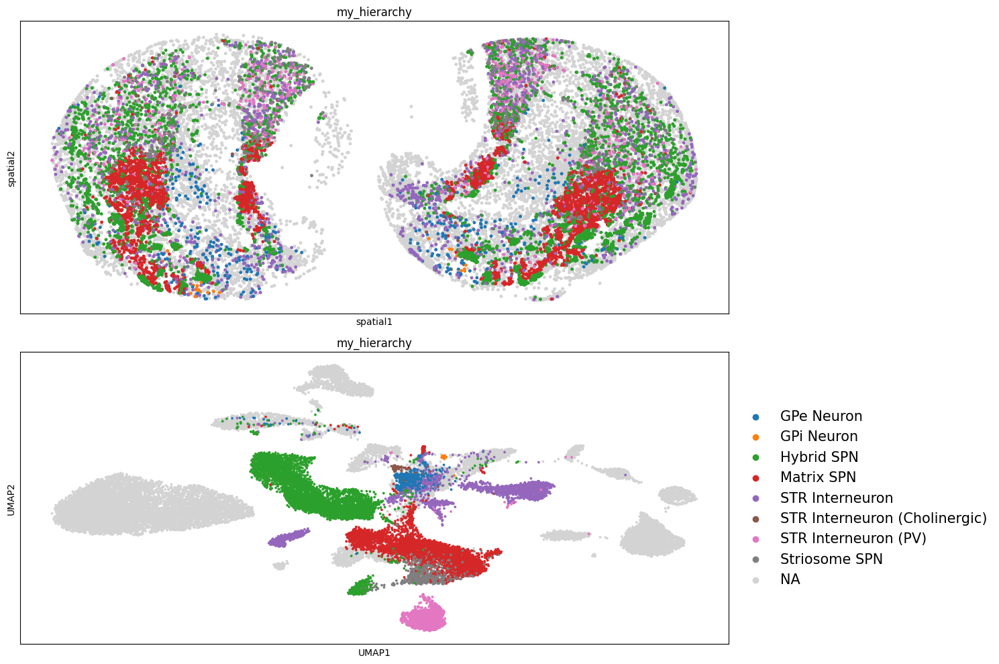

In [115]:
fig, axes = plt.subplots(2,1, figsize=(15,10))

adata_spatial = ad.AnnData(X=csr_matrix(adata.X.shape),obs=adata.obs.copy(),var=adata.var.copy(),uns=adata.uns.copy(),obsm=adata.obsm.copy())
adata_spatial = adata_spatial[adata_spatial.obs.has_spatial]

for i, res in enumerate(['my_hierarchy']):
    sc.pl.embedding(adata_spatial, basis="spatial", color=res, ax=axes[0], show=False, legend_loc=None, size=50)
    sc.pl.umap(adata, color=res, ax=axes[1], show=False, legend_fontsize=15, size=30)

plt.tight_layout()
plt.show()